In [83]:
%matplotlib inline
%config InlineBackend.figure_format = "retina"
from IPython.display import display
import importlib

In [45]:
## all inputs

# for viewer
root_dir = "/home/ysuzuki/work/RepeatAssembly/datruf_run/dmel/"
db_file = root_dir + "DMEL.db"
las_file = root_dir + "TAN.DMEL.las"
out_dir = root_dir + "tmp/"   # this should be a DB-specific directory, otherwise read ID probably conflicts

gepard_root = "/home/ysuzuki/work/software/gepard/"
gepard_jar = gepard_root + "dist/Gepard-1.40.jar"
gepard_mat = gepard_root + "resources/matrices/edna.mat"
gepard_command = "java -cp %s org.gepard.client.cmdline.CommandLine -matrix %s" % (gepard_jar, gepard_mat)

# for runner
dbdump = root_dir + "datander_dbdump"
ladump = root_dir + "datander_ladump"

# for plotter
with_extension_border = "/home/ysuzuki/work/RepeatAssembly/datander_dmel/compare_trf_and_datander/with_extension_border"
without_extension_border = "/home/ysuzuki/work/RepeatAssembly/datruf_run/dmel/without_extension_border"
without_extension_mean = "/home/ysuzuki/work/RepeatAssembly/datruf_run/dmel/without_extension_mean"
without_extension_median = "/home/ysuzuki/work/RepeatAssembly/datruf_run/dmel/without_extension_median"
trf = "/home/ysuzuki/work/RepeatAssembly/datander_dmel/compare_trf_and_datander/trf_result"
mtr = "/home/ysuzuki/work/RepeatAssembly/datander_dmel/compare_trf_and_datander/mtr_result"

# datruf viewer

Given a ID of one read (as used in DAZZ_DB), this viewer generates following plots:

1. dot plot (by gepard)
2. alignment plot (by datander; using start/end points of all self-vs-self alignments)
    * purple: TR alignments used for unit length estimation
    * red: TR alignments in the covering set
    * blue: other TR alignments
    * black: other alignments
    * [opt-in] green: grid lines staring from all start/end points
3. alignment path plot (by datander; only for puple alignments above)
    * black: daligner's trace of alignments
    * [opt-out] green: "reflecting snake" starting from the start position of each alignment
4. DAG constructed from each set of unit sequences

In [11]:
from datruf_viewer import Viewer

In [72]:
## reload modules (for debug)
import datruf_viewer, datruf_core, datruf_io, datruf_utils
importlib.reload(datruf_viewer)
importlib.reload(datruf_core)
importlib.reload(datruf_io)
importlib.reload(datruf_utils)
from datruf_viewer import Viewer

In [74]:
v = Viewer(root_dir, db_file, las_file, out_dir, gepard_command)

In [87]:
#v.set_read(22)
#v.dot_plot()
#v.alignment_plot()
#v.path_plot()
#v.consensus()

# datruf runner

In [33]:
!(python datruf_run.py --help)

usage: datruf_run.py [-h] [--dbdump DBDUMP] [--ladump LADUMP]
                     [--out_file OUT_FILE] [--start_dbid START_DBID]
                     [--end_dbid END_DBID] [--n_core N_CORE] [--on_the_fly]
                     db_file las_file

Run datruf with many reads

positional arguments:
  db_file               DAZZ_DB file
  las_file              output of TANmask

optional arguments:
  -h, --help            show this help message and exit
  --dbdump DBDUMP       output of `DBdump -r -h -mtan <db_file>`
  --ladump LADUMP       output of `LAdump -c <db_file> <las_file>`
  --out_file OUT_FILE
  --start_dbid START_DBID
                        Start read ID, which is used in DAZZ_DB.<= 1 for
                        starting from the first read. [1]
  --end_dbid END_DBID   End read ID. < 1 for ending at the last read. [-1]
  --n_core N_CORE       Degree of parallelization. [1]
  --on_the_fly          Generate dump data for each read on the fly.This mode
                        is ve

In [32]:
!(python datruf_run.py {db_file} {las_file} --dbdump {dbdump} --ladump {ladump} --start_dbid 1 --end_dbid 100; head -10 datruf_result)

	dbid	start	end	unit length
0	20	5	6887	18
1	22	899	2419	131
2	24	16	18250	5248
3	46	10450	23097	6057
4	53	11	20826	15
5	56	6943	8632	350
6	56	8633	10789	252
7	58	5444	9062	250
8	58	18662	22156	247
9	65	0	1409	308
10	82	1053	2800	370
11	84	1	6108	16
12	98	1336	3695	281


In [ ]:
# 15min for 10k reads (# all reads = 1.4M)

# datruf plotter

Plot results of datruf mainly for comparison with TRF and mTR

In [36]:
from datruf_plot import Plotter

In [66]:
## reload modules (for debug)
import datruf_plot
importlib.reload(datruf_plot)
from datruf_plot import Plotter

In [88]:
#p = Plotter(end_dbid=10000)
#p.add_result("wext_border", with_extension_border)
#p.add_result("woext_border", without_extension_border)
#p.add_result("woext_mean", without_extension_mean)
#p.add_result("woext_median", without_extension_median)

In [68]:
p = Plotter(end_dbid=10000)
p.add_result("datander", without_extension_mean)
p.add_result("TRF", trf)
p.add_result("mTR", mtr)

end dbid (datander) = 10000
end dbid (TRF) = 10000
end dbid (mTR) = 10000


In [80]:
results = p.get_results()
results.head()

,dbid,method,start,end,repeat length,unit length,copy number,unit sequence
0,20,datander,5,6887,6882,18,382.333333,NaN
1,20,TRF,5,6897,6892,13,530.153846,AAGAGAGAAAGAG
2,22,datander,899,2419,1520,131,11.603053,NaN
3,24,datander,16,18250,18234,5248,3.474466,NaN
4,39,mTR,2241,2315,74,7,10.571429,AATATAA


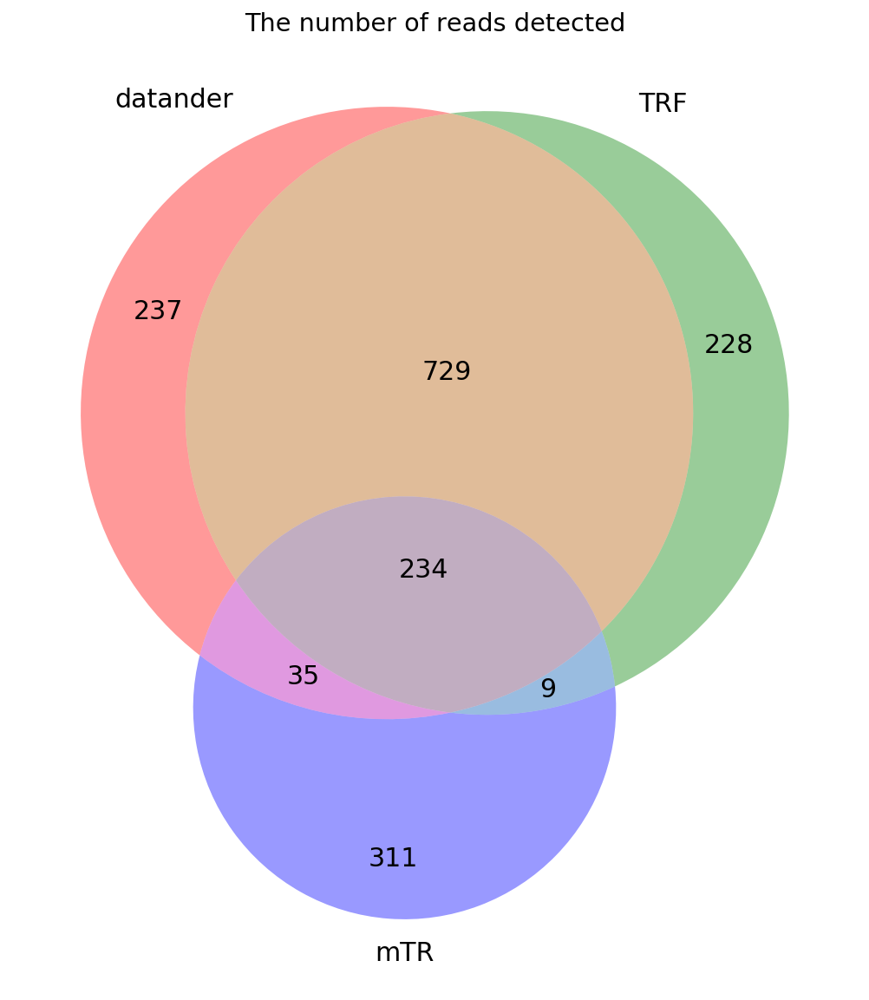

In [55]:
p.venn3_detected_read()

In [70]:
p.plot_unit_frequency()

In [69]:
p.plot_unit_length()

## Combined all-in-one function for single-read visualization

In [97]:
# Define v and results before using this!

def visualize(read_id, dot_plot=True, alignment_plot=True, path_plot=False, consensus=False):
    display(results[results["dbid"] == read_id])
    v.set_read(read_id)
    if dot_plot:
        v.dot_plot()
    if alignment_plot:
        v.alignment_plot()
    if path_plot:
        v.path_plot()
    if consensus:
        v.consensus()

# Examples

22, 929, 7291

,dbid,method,start,end,repeat length,unit length,copy number,unit sequence
2875,6936,mTR,2,9437,9435,5,1887.000000,ACACA
2876,6936,datander,15,9446,9431,74,127.445946,NaN
2877,6936,TRF,16,9446,9430,5,1886.000000,ACACA


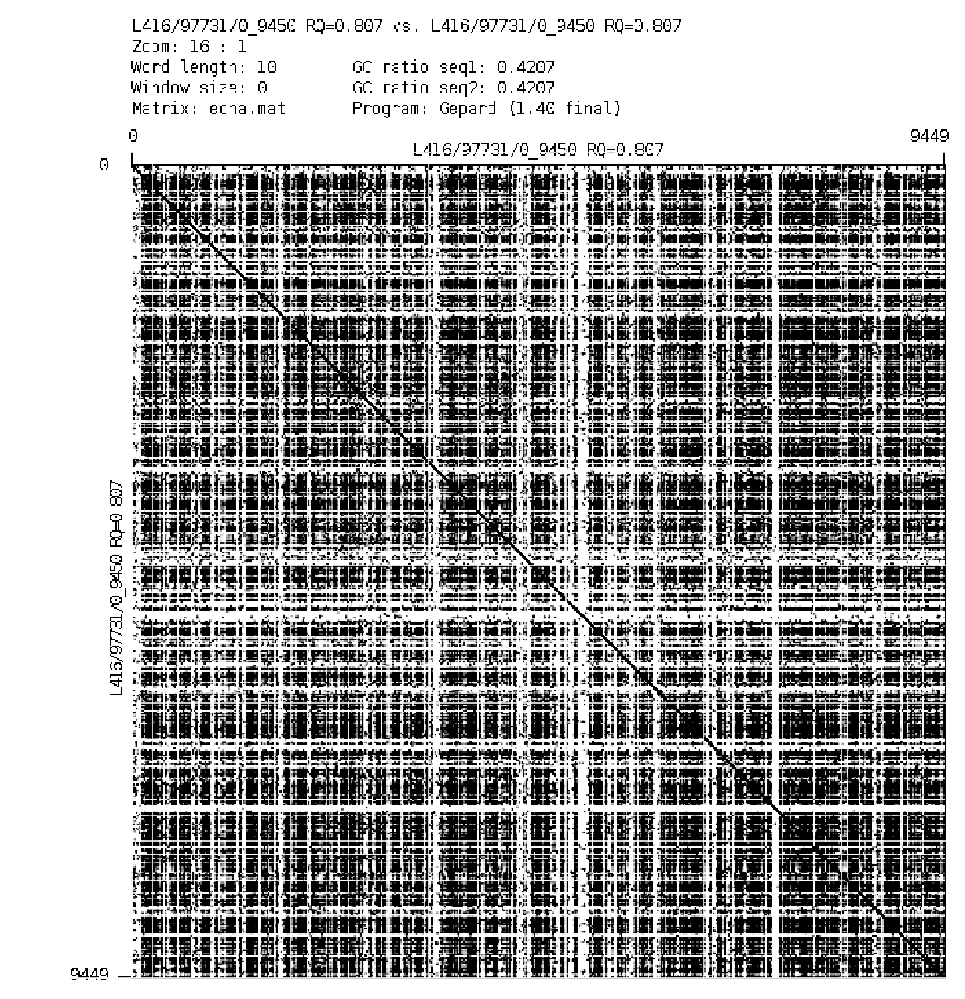

In [85]:
visualize(6936, path_plot=True)

-> **[MAJOR FIX 1]** Remove alignments in which variance of the unit lengths is high

,dbid,method,start,end,repeat length,unit length,copy number,unit sequence
1977,4610,datander,17,3534,3517,54,65.129630,NaN
1978,4610,mTR,17,3528,3511,12,292.583333,CGTACTCGGTCC
1979,4610,TRF,18,3542,3524,12,293.666667,CGTACTCGGTCC


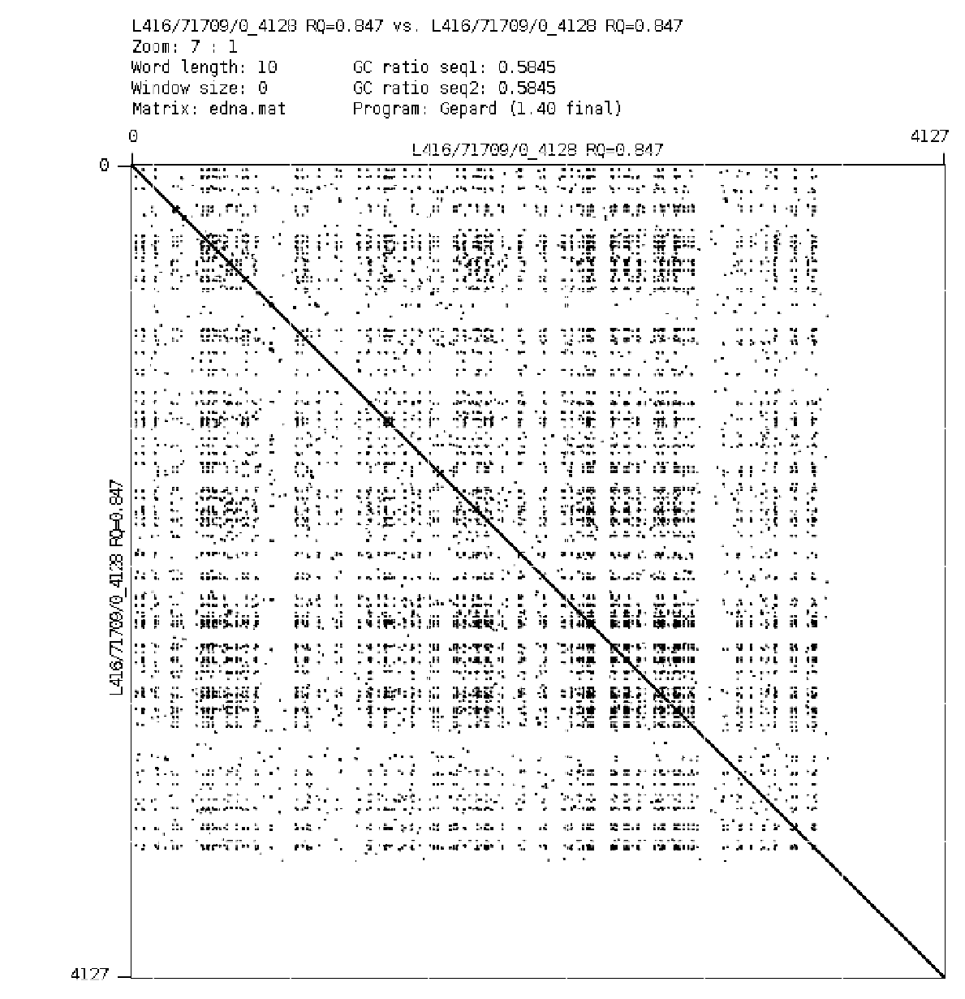

In [98]:
visualize(4610, path_plot=True)

-> [MF1]

,dbid,method,start,end,repeat length,unit length,copy number,unit sequence
3733,9047,datander,16,2632,2616,392,6.673469,NaN
3734,9047,mTR,16,26115,26099,360,72.497222,AATTTCGGTCATCAAATAATCATTTATTTTGCCACAACATTAAAAA...
3735,9047,datander,2649,12439,9790,385,25.428571,NaN
3736,9047,TRF,12298,12574,276,133,2.075188,AATTTTTTGGCATGATCAAAATAATCATTTATTTTTGCCACAACAT...
3737,9047,datander,13430,18589,5159,379,13.612137,NaN
3738,9047,datander,18590,20220,1630,374,4.358289,NaN
3739,9047,datander,20222,22560,2338,368,6.353261,NaN
3740,9047,datander,22566,24151,1585,364,4.354396,NaN
3741,9047,datander,24135,26126,1991,369,5.395664,NaN


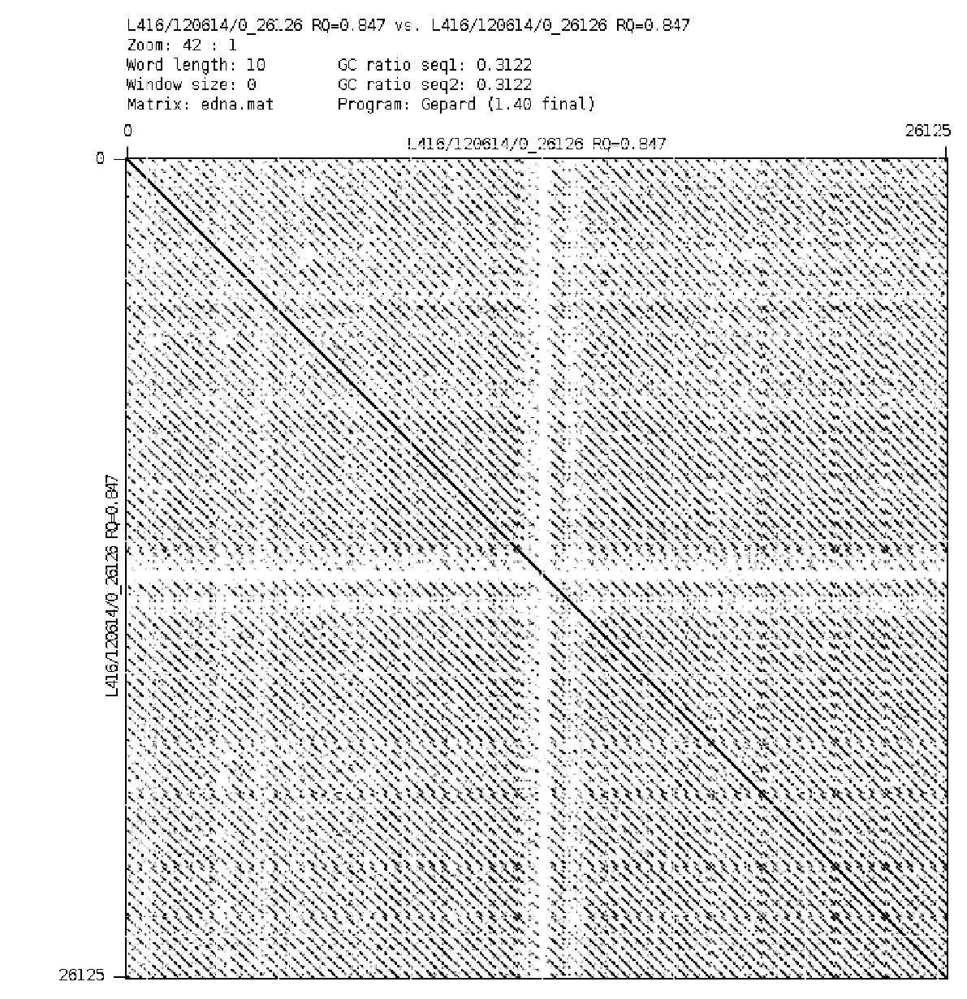

In [99]:
visualize(9047, path_plot=True)

,dbid,method,start,end,repeat length,unit length,copy number,unit sequence
4094,9975,TRF,10,26162,26152,5,5230.400000,TATAA
4095,9975,datander,12,26162,26150,85,307.647059,NaN
4096,9975,mTR,12,26157,26145,5,5229.000000,ATATA


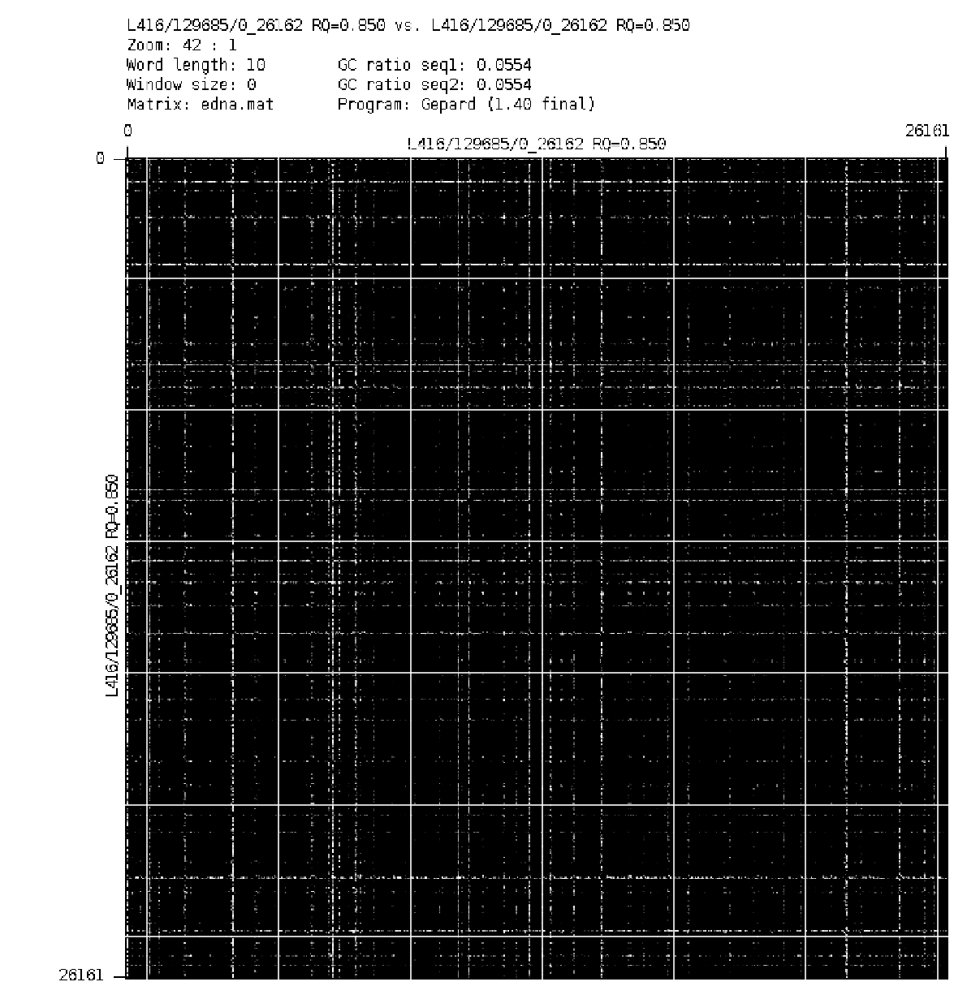

In [101]:
visualize(9975, path_plot=True)

,dbid,method,start,end,repeat length,unit length,copy number,unit sequence
1361,3316,TRF,958,8590,7632,236,32.338983,TTCTCTATAATACTTAGAGAATATGGGAATATTTCAACATTTTTCC...
1362,3316,datander,999,4508,3509,243,14.440329,NaN
1363,3316,datander,4187,5184,997,338,2.949704,NaN
1364,3316,datander,4857,8574,3717,241,15.423237,NaN
1365,3316,datander,17673,19003,1330,478,2.782427,NaN
1366,3316,TRF,17770,19032,1262,231,5.463203,AACAGCTAGCTTACACTACTATATCATTCCTAAAATGGTTTTCTCT...


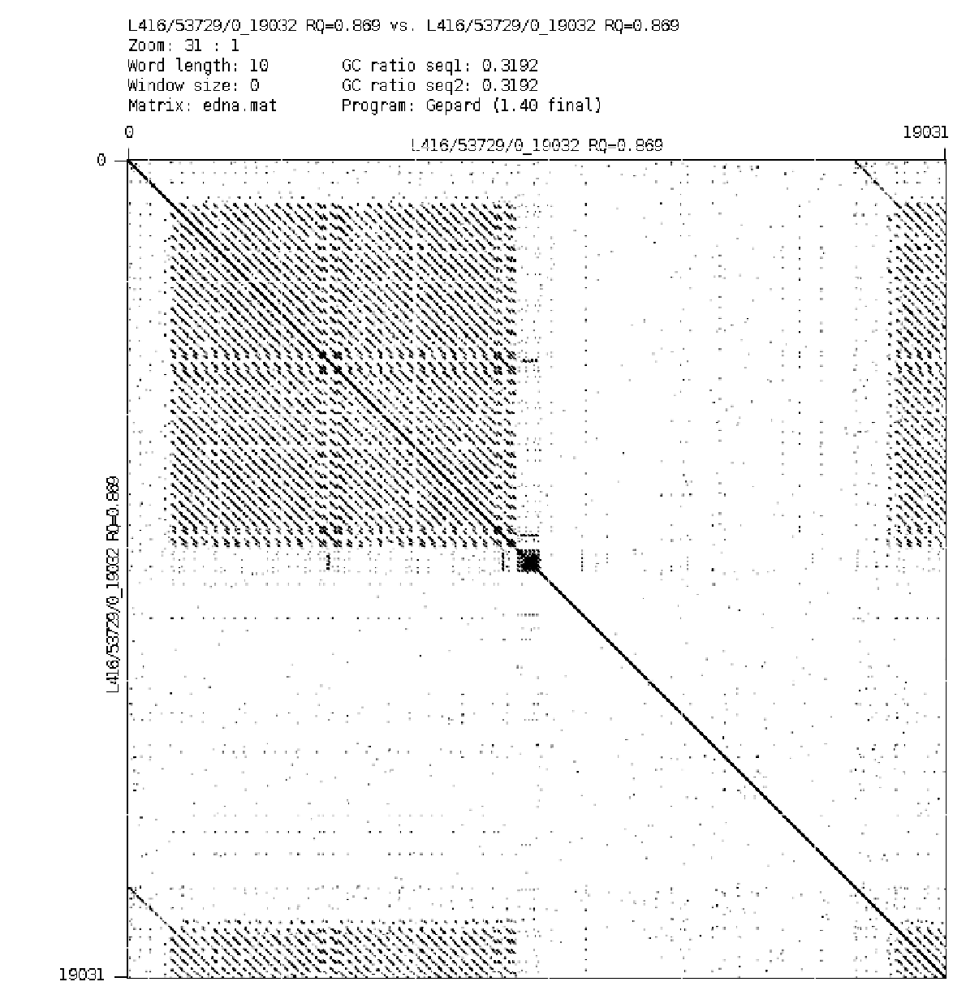

In [104]:
visualize(3316, path_plot=True)

,dbid,method,start,end,repeat length,unit length,copy number,unit sequence
2142,4993,datander,1033,1623,590,78,7.564103,NaN
2143,4993,datander,1568,2410,842,312,2.698718,NaN
2144,4993,datander,2247,3076,829,95,8.726316,NaN
2145,4993,datander,2945,5534,2589,47,55.085106,NaN
2146,4993,datander,5452,6631,1179,276,4.271739,NaN
2147,4993,datander,5701,7029,1328,171,7.766082,NaN
2148,4993,datander,7106,8385,1279,96,13.322917,NaN


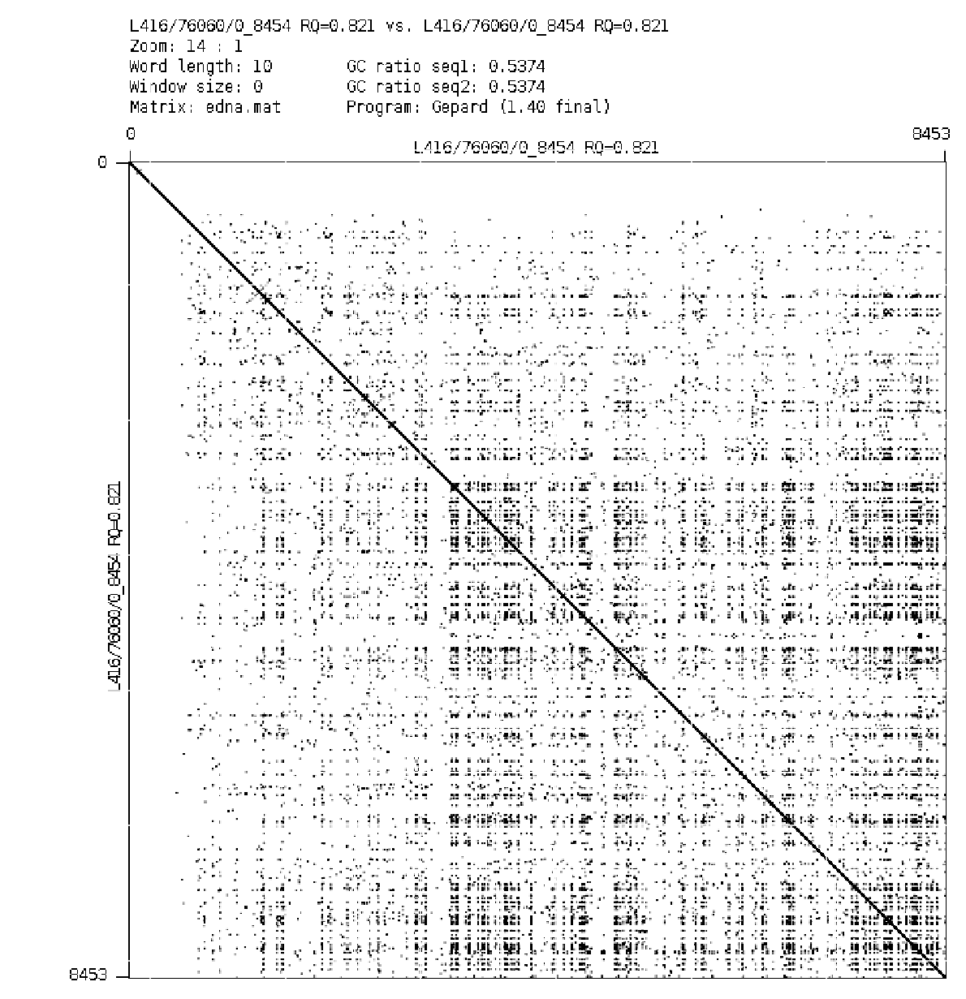

In [105]:
visualize(4993, path_plot=True)

,dbid,method,start,end,repeat length,unit length,copy number,unit sequence
3619,8768,mTR,1,15110,15109,8,1888.625000,AATTACTA
3620,8768,datander,3,3642,3639,33,110.272727,NaN
3621,8768,datander,8560,15039,6479,70,92.557143,NaN


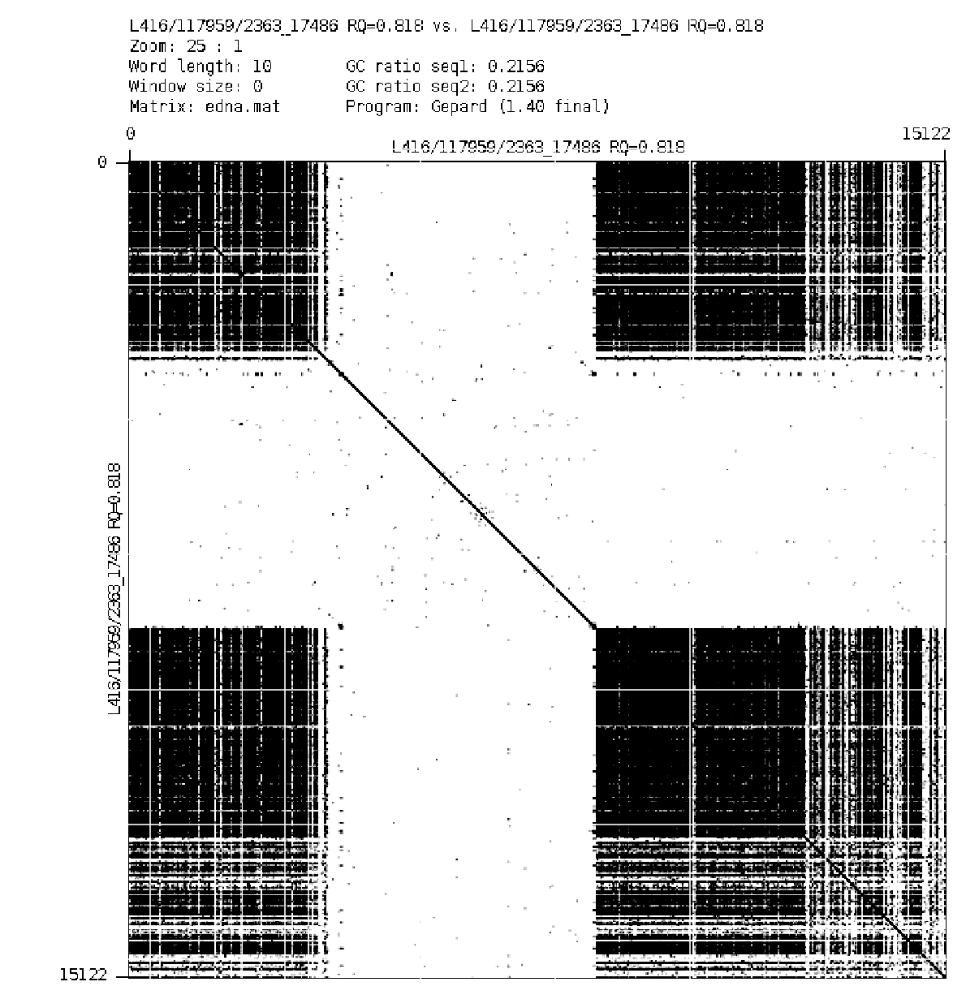

In [106]:
visualize(8768, path_plot=True)

,dbid,method,start,end,repeat length,unit length,copy number,unit sequence
1516,3580,TRF,12699,13392,693,204,3.397059,GATAAAAAACAAAAAAAAAAAAGAAAAAATAAAAAAATAAAAATGT...
1517,3580,datander,12760,13360,600,13,46.153846,NaN


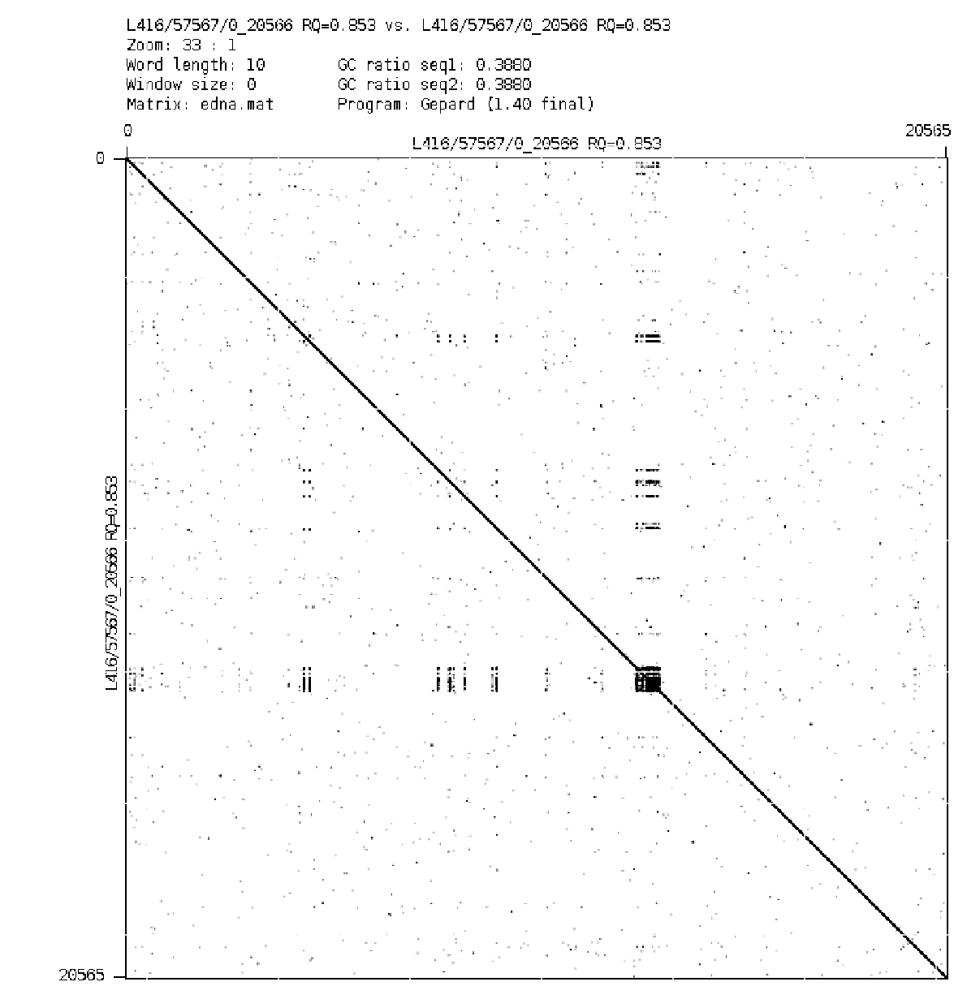

In [108]:
visualize(3580, path_plot=True)

,dbid,method,start,end,repeat length,unit length,copy number,unit sequence
2130,4990,datander,851,2378,1527,340,4.491176,NaN
2131,4990,datander,1411,3820,2409,119,20.243697,NaN
2132,4990,datander,3604,7750,4146,231,17.948052,NaN
2133,4990,datander,7813,8583,770,116,6.637931,NaN
2134,4990,datander,8384,9935,1551,229,6.772926,NaN
2135,4990,datander,10418,11591,1173,115,10.200000,NaN
2136,4990,datander,10480,12278,1798,359,5.008357,NaN
2137,4990,datander,13615,14378,763,114,6.692982,NaN
2138,4990,datander,14553,16289,1736,229,7.580786,NaN
2139,4990,datander,16337,17371,1034,234,4.418803,NaN


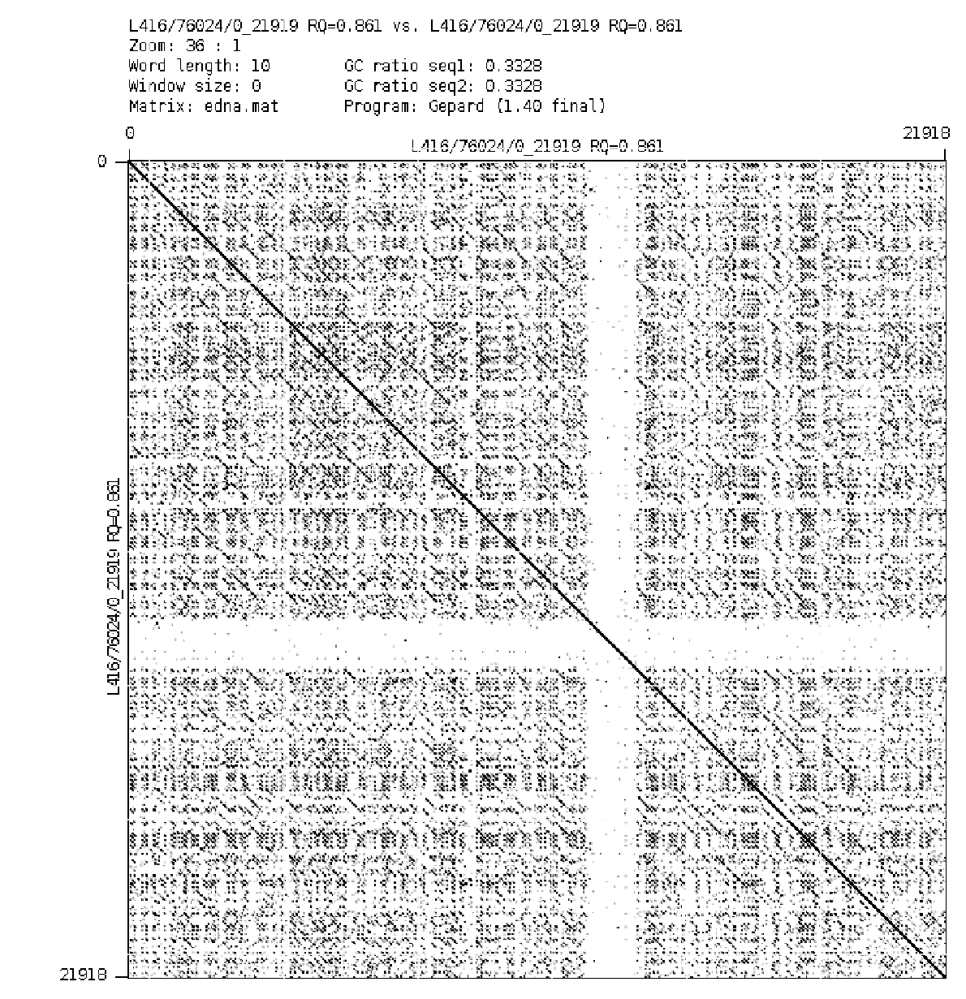

In [109]:
visualize(4990, path_plot=True)

,dbid,method,start,end,repeat length,unit length,copy number,unit sequence
3135,7594,mTR,75,22682,22607,10,2260.700000,TGTTATTCTA
3136,7594,datander,484,1557,1073,18,59.611111,NaN
3137,7594,datander,1417,2491,1074,109,9.853211,NaN
3138,7594,datander,3524,4507,983,94,10.457447,NaN
3139,7594,datander,3561,6485,2924,235,12.442553,NaN
3140,7594,datander,6406,12379,5973,13,459.461538,NaN
3141,7594,datander,11371,22689,11318,1316,8.600304,NaN


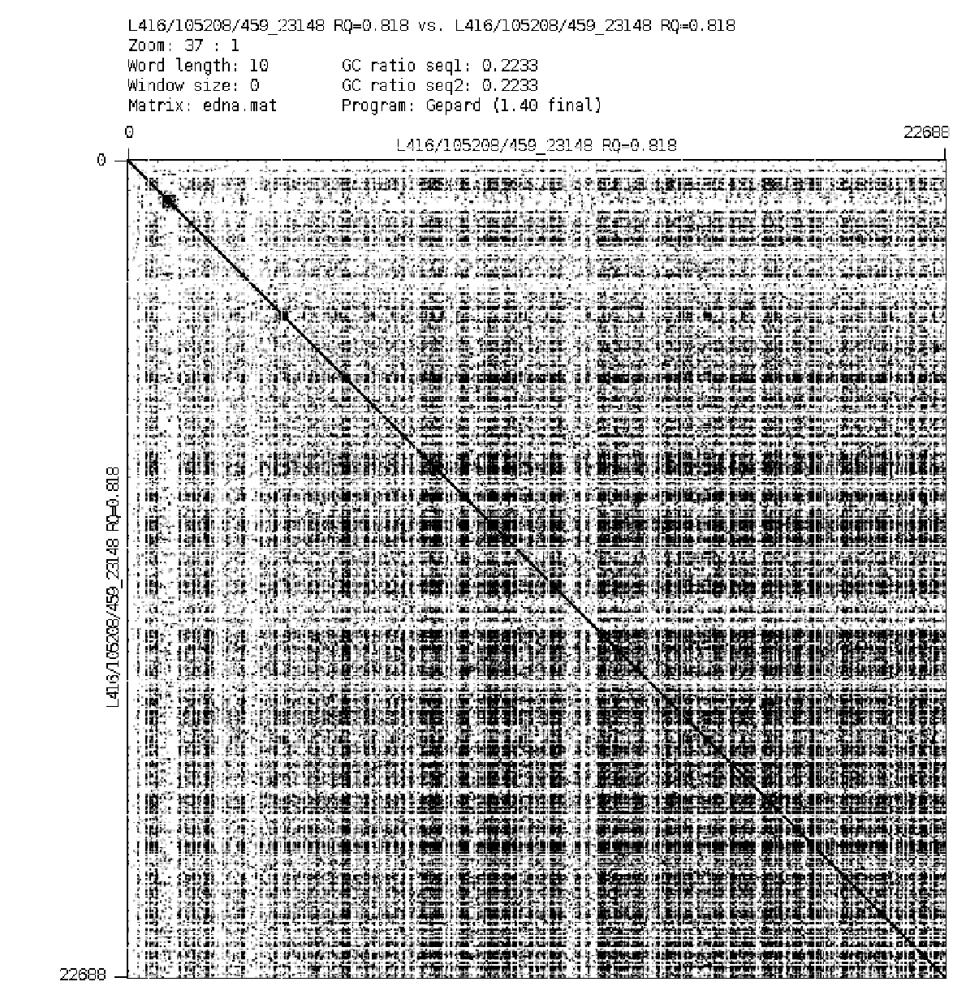

In [110]:
visualize(7594, path_plot=True)

,dbid,method,start,end,repeat length,unit length,copy number,unit sequence
3475,8320,datander,1032,3008,1976,422,4.682464,NaN
3476,8320,TRF,2223,2629,406,177,2.293785,TCTCTAGAGCTTGAATGCAATTTTCTCATGCTTTGCTACTTGATTA...
3477,8320,datander,2702,3799,1097,189,5.804233,NaN
3478,8320,TRF,3318,3822,504,181,2.784530,TTACTGGCTCCGGCAAGGAGGCCCGCGATATGGAGATTTCTTTCGC...


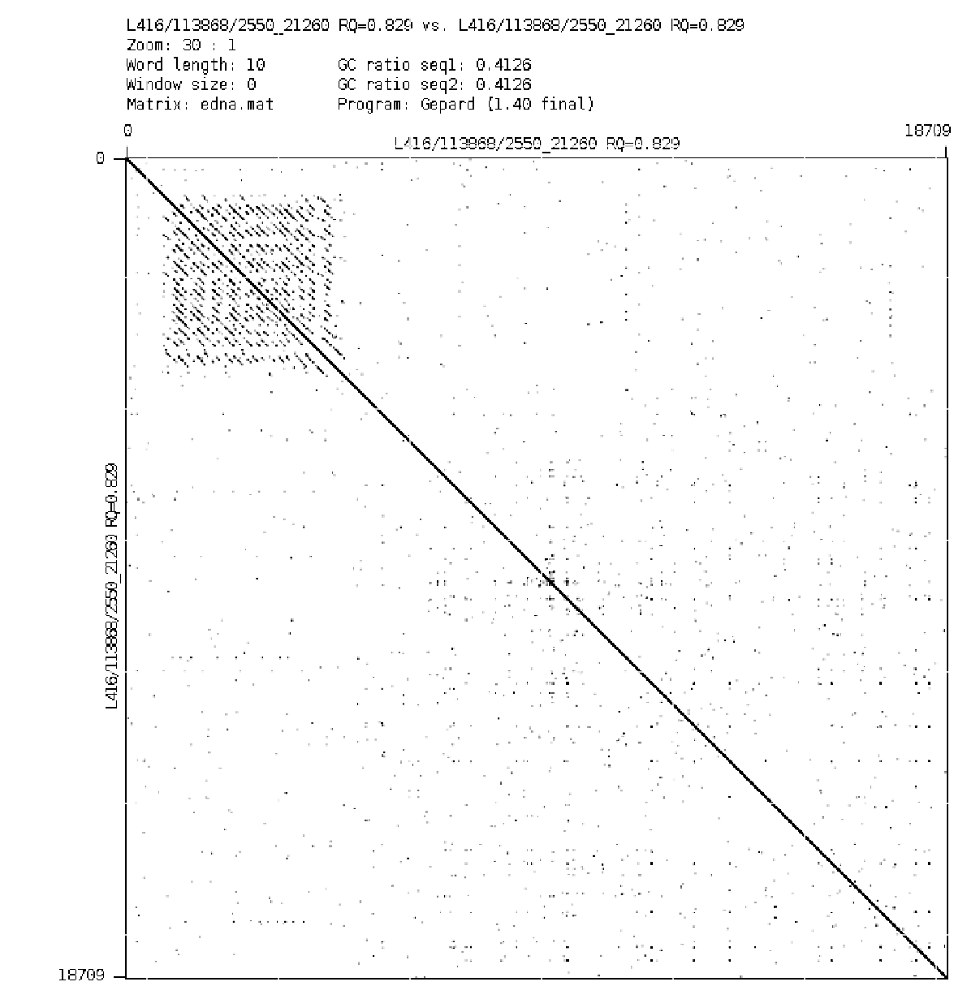

In [111]:
visualize(8320)